# 1. Импорт библиотек

In [95]:
import pandas as pd
import json
import re
from sklearn.preprocessing import MultiLabelBinarizer
from datetime import datetime
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, StandardScaler
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import auc, roc_auc_score, roc_curve,f1_score,mean_squared_error,confusion_matrix,accuracy_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score, KFold
import ast
import matplotlib.pyplot as plt
import seaborn as sns 
from sklearn.feature_selection import f_regression, mutual_info_regression,f_classif
from catboost import CatBoostRegressor
from sklearn.ensemble import RandomForestRegressor
from catboost import CatBoostRegressor, Pool, EShapCalcType, EFeaturesSelectionAlgorithm
import sys
from sklearn.cluster import DBSCAN
from collections import Counter
from matplotlib import rcParams

# 2.Вспомогательные функции

In [2]:
cat_list  = []
def category_list(col):
    if col not in cat_list:
        cat_list.append(col)
    print (cat_list)
    
bin_list  = []
def binary_list(col):
    if col not in bin_list:
        bin_list.append(col)
    print (bin_list)
    
num_list  = []
def numerical_list(col):
    if col not in num_list:
        num_list.append(col)
    print (num_list)
    
dum_list  = []
def dummy_list(col):
    if col not in dum_list:
        dum_list.append(col)
    print (dum_list)

def mape(actual, pred): 
    actual, pred = np.array(actual), np.array(pred)
    return np.mean(np.abs((actual - pred) / actual))

In [96]:
def pie(columns, data, title, figsize):
    fig, ax = plt.subplots(figsize=figsize, subplot_kw=dict(aspect="equal"))

    columns = columns

    data = data

    data_count = [x.split()[-1] for x in columns]


    def func(pct, allvals):
        absolute = int(np.round(pct/100.*np.sum(allvals)))
        return "{:.1f}%\n({:d})".format(pct, absolute)


    wedges, texts, autotexts = ax.pie(data, autopct=lambda pct: func(pct, data),
                                      textprops=dict(color="w"))

    ax.legend(wedges, data_count,
              title=title,
              loc="center left",
              bbox_to_anchor=(1, 0, 0.5, 1))

    plt.setp(autotexts, size=14, weight="bold")

    ax.set_title(title)

    plt.show()

def get_boxplot(column,dt):
    fig, ax = plt.subplots(figsize=(10, 10))
    sns.boxplot(x=column, y='price', data=dt, ax=ax, palette ="Spectral")
    plt.xticks(rotation=45)
    ax.set_title('Boxplot for ' + column)
    plt.show()


def check_dif(col):
    for i in df[col].unique():
        if i not in df_test[col].unique():
            print('df ',i, ' not in df_test')
    for i in df_test[col].unique():
        if i not in df[col].unique():
            print('df_test ',i,' not in df')
            
def compare_cols(col):
    df_compare = pd.DataFrame(df[col].value_counts()).merge(pd.DataFrame(
        df_test[col].value_counts()), left_index=True, right_index=True)
    return df_compare



def plot_cat_col_vs_price(data, col, num):
    num_categories = num
    values = data[col].value_counts().index
    if len(values) > num_categories:
        values = values[:num_categories]
    values = list(values)
    data_curr_categories = data.query(f"{col} in {values}")
    curr_categories = data_curr_categories[col].values
    sns.boxplot(x=curr_categories, y=data_curr_categories['price'], data = data)
    plt.title(f"Boxplot for {col}")
    plt.grid()
    
    
def categorial_feature(data, col, num, rotate=90, x_shift_mult=0, percentage=True): #, x_shift_mult=0, percentage=True, num):
    num_categories=num
    values = data[col].value_counts().index
    if len(values) > num_categories:
        values = values[:num_categories]
    values = list(values)
    data_curr_categories = data.query(f"{col} in {values}")
    curr_categories = data_curr_categories[col].values

    ax = sns.countplot(x=curr_categories, data=data, 
                       order=data[col].value_counts().index[:num_categories], 
                       orient="h", palette ="Spectral")
    
    if percentage:
        total = len(data[col])
        for p in ax.patches:
            percentage = '{:.1f}%'.format(100 * p.get_height()/total) #добавим в подпись процентное соотношение
            x = p.get_x() + x_shift_mult*p.get_width()
            y = p.get_y() + p.get_height()+8
            ax.annotate(percentage, (x, y)) 
    plt.xticks(rotation=rotate)

# 3. Загрузка датасетов

In [6]:
# без цен
# df_test = pd.read_csv('../input/sf-dst-car-price-prediction/test.csv',low_memory=False, encoding = 'UTF-8')
df_test = pd.read_csv('test.csv',low_memory=False, encoding = 'UTF-8')
# спарсеный с ценами 20/10/2021
# df = pd.read_csv('../input/dataset-cars-autoru/dataset_V2.csv',encoding = 'UTF-8')
df = pd.read_csv('dataset_V2.csv',encoding = 'UTF-8')
df = df.drop('Unnamed: 0', axis=1)
df = df.dropna()

# результат
sample_submission = pd.read_csv('sample_submission.csv')

# 4. Сравним данные представленные в датасетах

In [7]:
print(f"Кол-во строк : {len(df_test)}, Кол-во признаков : {len(df_test.columns)}")
print(f"Кол-во строк : {len(df)}, Кол-во признаков : {len(df.columns)}")

Кол-во строк : 34686, Кол-во признаков : 35
Кол-во строк : 94352, Кол-во признаков : 29


### Посмотрим внимательнее на колонки которых нет в спарсеном датасете

In [10]:
df_test[[x for x in df_test.columns if x not in df.columns]].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34686 entries, 0 to 34685
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Unnamed: 0          34686 non-null  int64 
 1   complectation_dict  6418 non-null   object
 2   image               34686 non-null  object
 3   name                34686 non-null  object
 4   parsing_unixtime    34686 non-null  int64 
 5   priceCurrency       34686 non-null  object
 6   sell_id             34686 non-null  int64 
 7   Владение            11995 non-null  object
dtypes: int64(3), object(5)
memory usage: 2.1+ MB


много пропусков в complectation_dict и Владение

In [11]:
# complectation_dict
df_test.complectation_dict[2]

'{"id":"20026336","name":"Ambition","available_options":["heated-wash-system","airbag-passenger","lock","door-sill-panel","electro-mirrors","mirrors-heat","cooling-box","computer","seat-transformation","wheel-power","fabric-seats","airbag-side","abs","wheel-leather","climate-control-1","esp","adaptive-light","audiopreparation","ashtray-and-cigarette-lighter","front-centre-armrest","electro-window-back","16-inch-wheels","body-mouldings","condition","airbag-driver","isofix","aux","electro-window-front","light-sensor","hcc","ptf","rain-sensor","tyre-pressure","audiosystem-cd","front-seats-heat","wheel-configuration2","wheel-configuration1","immo","12v-socket","third-rear-headrest"]}'

In [12]:
# image
df_test.image

# изображения авто, если бы мы умели определять стоимость по фото, то оставили

0        https://autoru.naydex.net/o9DBXQ270/5ac010hAY0...
1        https://autoru.naydex.net/o9DBXQ270/5ac010hAY0...
2        https://avatars.mds.yandex.net/get-autoru-vos/...
3        https://autoru.naydex.net/o9DBXQ270/5ac010hAY0...
4        https://autoru.naydex.net/o9DBXQ270/5ac010hAY0...
                               ...                        
34681    https://autoru.naydex.net/nwI1K7152/b604fdsYg7...
34682    https://autoru.naydex.net/nwI1K7152/b604fdsYg7...
34683    https://avatars.mds.yandex.net/get-autoru-vos/...
34684    https://autoru.naydex.net/nwI1K7152/b604fdsYg7...
34685    https://avatars.mds.yandex.net/get-autoru-vos/...
Name: image, Length: 34686, dtype: object

In [13]:
# name
df_test.name

# создадим name в df
df['name'] = df['super_gen'].apply(lambda x: ast.literal_eval(x)['human_name'])

In [14]:
# parsing_unixtime перобразем в дату
df_test['parsing_date'] = df_test['parsing_unixtime'].apply(
    lambda x: datetime.fromtimestamp(x).strftime('%Y-%m-%d'))

# создадим дату парсинга в df
df['parsing_date'] = '2021-11-12'

# parsing_unixtime удаляем

In [15]:
# priceCurrency
df_test.priceCurrency.value_counts()

# удаляем

RUB    34686
Name: priceCurrency, dtype: int64

In [16]:
# Владение
df_test.Владение[34681]

'2 года и 1 месяц'

In [17]:
# sell_id
df_test.sell_id.duplicated().value_counts()
# False    34686

# создадим sell_id в df
df['sell_id'] = df['car_url'].apply(lambda x: x.split('/')[8].split('-')[0])

# проверим на дубликаты
df.sell_id.duplicated().value_counts()
# False    95114
# True       762

# удалим дубликаты
df = df.drop(df[df.duplicated(subset=['sell_id'])].index)
df = df.reset_index(drop = True)

- complectation_dict - информация практически идентичная equipment_dict => удаляем
- Владение - много не восполнимых пропусков => удаляем

In [18]:
df_test = df_test.drop(['complectation_dict','Владение','image','parsing_unixtime','priceCurrency'],axis=1)

### Посмотрим внимательнее на колонки которых нет в спарсеном датасете

In [19]:
df[[x for x in df.columns if x not in df_test.columns]].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94352 entries, 0 to 94351
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   price   94352 non-null  float64
 1   id_car  94352 non-null  int64  
dtypes: float64(1), int64(1)
memory usage: 1.4 MB


In [20]:
df_test['price'] = 0

In [21]:
# сделаем последовательность колонок идентичными
df = df.reindex(columns=df_test.columns)

### Проверим идентичность Dtype

In [22]:
dtype = dict(df.dtypes == df_test.dtypes)
for i in dtype:
    if dtype[i] == False:
        print(i,'\n',
              'df',df.dtypes[i],'\n',
              'df_test',df_test.dtypes[i])

Unnamed: 0 
 df float64 
 df_test int64
mileage 
 df float64 
 df_test int64
modelDate 
 df float64 
 df_test int64
numberOfDoors 
 df float64 
 df_test int64
productionDate 
 df float64 
 df_test int64
sell_id 
 df object 
 df_test int64
Владельцы 
 df float64 
 df_test object
Состояние 
 df bool 
 df_test object
Таможня 
 df bool 
 df_test object
price 
 df float64 
 df_test int64


In [23]:
df.mileage = df.mileage.apply(lambda x: int(x))
df.modelDate = df.modelDate.apply(lambda x: int(x))
df.numberOfDoors = df.numberOfDoors.apply(lambda x: int(x))
df.productionDate = df.productionDate.apply(lambda x: int(x))
df.sell_id = df.sell_id.apply(lambda x: int(x))
df.price = df.price.apply(lambda x: int(x))

In [24]:
df_test['Владельцы']

0        3 или более
1         1 владелец
2         1 владелец
3         1 владелец
4         1 владелец
            ...     
34681    3 или более
34682     1 владелец
34683    3 или более
34684    2 владельца
34685    3 или более
Name: Владельцы, Length: 34686, dtype: object

In [25]:
df_test['Владельцы'] = df_test['Владельцы'].apply(lambda x: int((re.findall(r'\d', x)[0])))

Данные приведены к единому формату, рассмотрим признаки

## Обработка признаков

In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94352 entries, 0 to 94351
Data columns (total 32 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Unnamed: 0            0 non-null      float64
 1   Unnamed: 0.1          94352 non-null  int64  
 2   bodyType              94352 non-null  object 
 3   brand                 94352 non-null  object 
 4   car_url               94352 non-null  object 
 5   color                 94352 non-null  object 
 6   description           94352 non-null  object 
 7   engineDisplacement    94352 non-null  object 
 8   enginePower           94352 non-null  object 
 9   equipment_dict        94352 non-null  object 
 10  fuelType              94352 non-null  object 
 11  mileage               94352 non-null  int64  
 12  modelDate             94352 non-null  int64  
 13  model_info            94352 non-null  object 
 14  model_name            94352 non-null  object 
 15  name               

In [27]:
# bodyType

check_dif('bodyType')
# df_test  фастбек  not in df

df_test[df_test.bodyType == 'фастбек']['model_name']
# заменим на схожий
df_test.loc[df_test[df_test['bodyType']=='фастбек'].index,'bodyType'] = 'лифтбек'

category_list('bodyType')

check_dif('bodyType')

df_test  фастбек  not in df
['bodyType']


In [28]:
# brand

check_dif('brand')
category_list('brand')

['bodyType', 'brand']


In [29]:
# color

check_dif('color')
category_list('color')

['bodyType', 'brand', 'color']


In [30]:
# engineDisplacement

check_dif('engineDisplacement')
df_test[df_test.engineDisplacement == '5.3 LTR'][[
    'brand', 'model_name', 'description']]
category_list('engineDisplacement')

# создадим engineDisplacement_num
df_test['engineDisplacement_num'] = df_test['engineDisplacement'].apply(
    lambda x: float(x.split(' ')[0]) if x.split(' ')[0] != '' else 0)
df['engineDisplacement_num'] = df['engineDisplacement'].apply(
    lambda x: float(x.split(' ')[0]) if x.split(' ')[0] != '' else 0)

numerical_list('engineDisplacement_num')

df_test  5.3 LTR  not in df
['bodyType', 'brand', 'color', 'engineDisplacement']
['engineDisplacement_num']


In [31]:
# enginePower

df_test['enginePower'] = df_test['enginePower'].apply(lambda x: int(x.split(sep=' ')[0]))
df['enginePower'] = df['enginePower'].apply(lambda x: int(x.split(sep=' ')[0]))

numerical_list('enginePower')

['engineDisplacement_num', 'enginePower']


In [32]:
# equipment_dict

len(df[df.equipment_dict == '{}'])
# 29453

len(df_test[df_test.equipment_dict.isna()])
# 9996

# видим пропуски в equipment_dict, заполним их самой распространенной комплектацией в бренде, 
# для этого создадим дополнительные признаки

df_test['equipment_list'] = df_test['equipment_dict'].apply(
    lambda x: sorted(list(json.loads(x).keys())) if type(x) != float else None)

df['equipment_list'] = df['equipment_dict'].apply(lambda x: sorted(
    list(ast.literal_eval(x).keys())) if x != '{}' else None)

df['len_quip_list'] = df[df['equipment_list'].notna()]['equipment_list'].apply(lambda x: int(len(x)) )
df_test['len_quip_list'] = df_test[df_test['equipment_list'].notna()]['equipment_list'].apply(lambda x: int(len(x)) )

df['sorted_quip_list'] = df[df['equipment_list'].notna()]['equipment_list'].apply(lambda x: str(x) )
df_test['sorted_quip_list'] = df_test[df_test['equipment_list'].notna()]['equipment_list'].apply(lambda x: str(x) )

# объеденим
df_equip = df[['equipment_list', 'brand', 'len_quip_list',
               'sorted_quip_list']].append(df_test[['equipment_list', 'brand', 'len_quip_list',
               'sorted_quip_list']], sort=False).reset_index(drop=True)

# создадим словарь с распространенной комплектацией
equip_pop_dict = {}
error_dict = []
for i in df_equip[df_equip['equipment_list'].isna()]['brand'].unique():
    try:
        equip_pop_dict[i] = df_equip[(df_equip['brand'] == i) & (
            df_equip['equipment_list'].notna()) & (df_equip['len_quip_list'] > 2)]['sorted_quip_list'].value_counts().keys()[0]
    except :
        error_dict.append(i)
        continue

# заполним пропуски

df.loc[df['sorted_quip_list'].isna(),'sorted_quip_list'] = df['brand'].apply(lambda x: equip_pop_dict[x])
df_test.loc[df_test['sorted_quip_list'].isna(),'sorted_quip_list'] = df_test['brand'].apply(lambda x: equip_pop_dict[x])

df.loc[df['equipment_list'].isna(),'equipment_list'] = df['sorted_quip_list'].apply(lambda x: x[2:-2].split("', '"))
df_test.loc[df_test['equipment_list'].isna(),'equipment_list'] = df_test['sorted_quip_list'].apply(lambda x: x[2:-2].split("', '"))

# удалим вспомогательные признаки и обновим len_quip_list

df = df.drop(['equipment_dict','sorted_quip_list'],axis=1)
df_test = df_test.drop(['equipment_dict','sorted_quip_list'],axis=1)

df['len_quip_list'] = df['equipment_list'].apply(lambda x: int(len(x)))
df_test['len_quip_list'] = df_test['equipment_list'].apply(lambda x: int(len(x)))

# добавим в dummy_list, потом извлечем признаки перед обработкой
dummy_list('equipment_list')
numerical_list('len_quip_list')

['equipment_list']
['engineDisplacement_num', 'enginePower', 'len_quip_list']


In [33]:
# fuelType

check_dif('fuelType')
# разницы не обнаружено

category_list('fuelType')

['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType']


In [34]:
# mileage

df_test['mileage']

numerical_list('mileage')

['engineDisplacement_num', 'enginePower', 'len_quip_list', 'mileage']


In [35]:
# modelDate

check_dif('modelDate')
category_list('modelDate')

df  1957  not in df_test
df  1961  not in df_test
df  1967  not in df_test
df_test  1969  not in df
df_test  1934  not in df
df_test  1966  not in df
df_test  1965  not in df
df_test  1904  not in df
df_test  1963  not in df
['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate']


In [36]:
# model_info

#извлечем признак morfology
df['morfology'] = df['model_info'].apply(
    lambda x: 'FEMININE' if len(ast.literal_eval(x)) == 1 else 'MASCULINE')
df_test['morfology'] = df_test['model_info'].apply(
    lambda x: 'FEMININE' if len(json.loads(x)['morphology']) == 1 else 'MASCULINE')

binary_list('morfology')

df = df.drop(['model_info'],axis=1)
df_test = df_test.drop(['model_info'],axis=1)

['morfology']


In [37]:
# model_name

df['model_name'] = df['car_url'].apply(lambda x: x.split('/')[7].upper())
check_dif('model_name')

# избавимся от моделей которых нет в df_test
for i in df['model_name'].unique():
    if i not in df_test['model_name'].unique():
        df = df.drop(df[df['model_name'] == i].index).reset_index(drop=True)


df  RS3  not in df_test
df  RS5  not in df_test
df  RSQ3  not in df_test
df  RS6  not in df_test
df  RS7  not in df_test
df  RS4  not in df_test
df  SQ7  not in df_test
df  Q3_SPORTBACK  not in df_test
df  SQ8  not in df_test
df  E_TRON_SPORTBACK  not in df_test
df  LIFE  not in df_test
df  FIT_ARIA  not in df_test
df  CAPA  not in df_test
df  INTEGRA_SJ  not in df_test
df  S_MX  not in df_test
df  PASSPORT  not in df_test
df  FIT_SHUTTLE  not in df_test
df  EDIX  not in df_test
df  VAMOS  not in df_test
df  THATS  not in df_test
df  MDX  not in df_test
df  BEAT  not in df_test
df  ASCOT_INNOVA  not in df_test
df  FCX_CLARITY  not in df_test
df  JADE  not in df_test
df  GRACE  not in df_test
df  N_ONE  not in df_test
df  S660  not in df_test
df  N_BOX_SLASH  not in df_test
df  V40_CC  not in df_test
df  V90  not in df_test
df  300_SERIES  not in df_test
df  M8  not in df_test
df  Z3M  not in df_test
df  TITAN  not in df_test
df  ROOX  not in df_test
df  ROGUE  not in df_test
df  DUALIS

In [38]:
category_list('model_name')

['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate', 'model_name']


In [39]:
# name

df.name
df_test.name
# признак состоит из нескольких признаков присутствующих в датасетах, удалим его
df = df.drop('name',axis=1)
df_test = df_test.drop('name',axis=1)

In [40]:
# numberOfDoors

check_dif('numberOfDoors')
category_list('numberOfDoors')

df_test  0  not in df
['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate', 'model_name', 'numberOfDoors']


In [41]:
# productionDate

check_dif('productionDate')
# датасете с ценами отсутствуют раритетные модели, разберемся с этим позже
numerical_list('productionDate')

df_test  1939  not in df
df_test  1970  not in df
df_test  1936  not in df
df_test  1904  not in df
df_test  1967  not in df
df_test  1965  not in df
['engineDisplacement_num', 'enginePower', 'len_quip_list', 'mileage', 'productionDate']


In [42]:
# super_gen

df.super_gen[0]
df_test.super_gen[0]

# '{"id":"10373605","displacement":1197,"engine_type":"GASOLINE","gear_type":"FORWARD_CONTROL",
# "transmission":"ROBOT","power":105,"power_kvt":77,"human_name":"1.2 AMT (105 л.с.)","acceleration":10.5,
# "clearance_min":155,"fuel_rate":5}'

# извлечем признаки acceleration, clearance_min, fuel_rate

df['acceleration_super_gen'] = df['super_gen'].apply(
    lambda x: ast.literal_eval(x)['acceleration'] if 'acceleration' in ast.literal_eval(x).keys() else -1)

df['clearance_min_super_gen'] = df['super_gen'].apply(
    lambda x: ast.literal_eval(x)['clearance_min'] if 'clearance_min' in ast.literal_eval(x).keys() else -1)

df['fuel_rate_super_gen'] = df['super_gen'].apply(
    lambda x: ast.literal_eval(x)['fuel_rate'] if 'fuel_rate' in ast.literal_eval(x).keys() else -1)

df_test['acceleration_super_gen'] = df_test['super_gen'].apply(
    lambda x: json.loads(x)['acceleration'] if 'acceleration' in json.loads(x).keys() else -1)

df_test['clearance_min_super_gen'] = df_test['super_gen'].apply(
    lambda x: json.loads(x)['clearance_min'] if 'clearance_min' in json.loads(x).keys() else -1)

df_test['fuel_rate_super_gen'] = df_test['super_gen'].apply(
    lambda x: json.loads(x)['fuel_rate'] if 'fuel_rate' in json.loads(x).keys() else -1)

df = df.drop('super_gen', axis=1)
df_test = df_test.drop('super_gen', axis=1)

In [43]:
df.fuel_rate_super_gen.value_counts()

-1.0     4949
 7.4     2270
 6.7     2125
 7.9     2051
 7.5     2027
         ... 
 15.9       1
 1.4        1
 18.2       1
 17.8       1
 2.0        1
Name: fuel_rate_super_gen, Length: 152, dtype: int64

In [44]:
# acceleration_super_gen

df['acceleration_super_gen'].value_counts()

# получилось много пропущеных строк в acceleration_super_gen,fuel_rate_super_gen удалим их
df = df.drop(['acceleration_super_gen','fuel_rate_super_gen'], axis=1)
df_test = df_test.drop(['acceleration_super_gen','fuel_rate_super_gen'], axis=1)
numerical_list('clearance_min_super_gen')


['engineDisplacement_num', 'enginePower', 'len_quip_list', 'mileage', 'productionDate', 'clearance_min_super_gen']


In [45]:
# vehicleConfiguration

check_dif('vehicleConfiguration')
df.vehicleConfiguration.value_counts()

# нет полезной информации, удаляем
df = df.drop('vehicleConfiguration', axis=1)
df_test = df_test.drop('vehicleConfiguration', axis=1)


df  LIFTBACK ROBOT 1.5  not in df_test
df  SEDAN AUTOMATIC 1.4  not in df_test
df  LIFTBACK AUTOMATIC 1.4  not in df_test
df  WAGON_5_DOORS VARIATOR 2.8  not in df_test
df  CABRIO VARIATOR 2.0  not in df_test
df  WAGON_5_DOORS ROBOT 2.8  not in df_test
df  LIFTBACK VARIATOR 2.8  not in df_test
df  CABRIO ROBOT 1.8  not in df_test
df  CABRIO ROBOT 1.4  not in df_test
df  COUPE VARIATOR 2.7  not in df_test
df  ROADSTER ROBOT 2.0  not in df_test
df  ROADSTER MECHANICAL 2.0  not in df_test
df  ROADSTER ROBOT 3.2  not in df_test
df  ALLROAD_5_DOORS MECHANICAL 3.6  not in df_test
df  COUPE ROBOT 1.8  not in df_test
df  CABRIO VARIATOR 3.2  not in df_test
df  LIFTBACK ROBOT 3.2  not in df_test
df  WAGON_5_DOORS VARIATOR 3.1  not in df_test
df  WAGON_5_DOORS MECHANICAL 4.2  not in df_test
df  SEDAN MECHANICAL 3.1  not in df_test
df  WAGON_5_DOORS VARIATOR 1.9  not in df_test
df  SEDAN MECHANICAL 4.2  not in df_test
df  COUPE MECHANICAL 2.6  not in df_test
df  HATCHBACK_3_DOORS VARIATOR 1.6  no

df_test  ROADSTER AUTOMATIC 2.3  not in df
df_test  SEDAN AUTOMATIC 6.2  not in df
df_test  ALLROAD_5_DOORS AUTOMATIC 5.4  not in df
df_test  ALLROAD_5_DOORS AUTOMATIC 6.2  not in df
df_test  COUPE_HARDTOP AUTOMATIC 4.7  not in df
df_test  PICKUP_TWO AUTOMATIC 2.3  not in df
df_test  COUPE AUTOMATIC 5.0  not in df
df_test  COUPE_HARDTOP AUTOMATIC 6.0  not in df
df_test  COUPE_HARDTOP AUTOMATIC 3.5  not in df
df_test  WAGON_5_DOORS AUTOMATIC 4.7  not in df
df_test  COUPE AUTOMATIC 5.4  not in df
df_test  WAGON_5_DOORS AUTOMATIC 5.5  not in df
df_test  COUPE_HARDTOP AUTOMATIC 3.2  not in df
df_test  COUPE AUTOMATIC 5.6  not in df
df_test  WAGON_5_DOORS AUTOMATIC 5.4  not in df
df_test  WAGON_5_DOORS AUTOMATIC 3.5  not in df
df_test  COUPE_HARDTOP MECHANICAL 2.3  not in df
df_test  ROADSTER AUTOMATIC 5.5  not in df
df_test  COUPE AUTOMATIC 4.3  not in df
df_test  COUPE_HARDTOP AUTOMATIC 5.8  not in df
df_test  ROADSTER AUTOMATIC 4.7  not in df
df_test  LIMOUSINE AUTOMATIC 5.5  not in df
d

In [42]:
# vehicleTransmission

check_dif('vehicleTransmission')
category_list('vehicleTransmission')

['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate', 'model_name', 'numberOfDoors', 'vehicleTransmission']


In [46]:
# vendor

check_dif('vendor')

df = df.drop(df[df['vendor'] == 'AMERICAN'].index).reset_index(drop=True)
binary_list('vendor')

df  AMERICAN  not in df_test
['morfology', 'vendor']


In [47]:
# Владельцы

check_dif('Владельцы')

df['Владельцы'] = df['Владельцы'].apply(lambda x: 3 if x == 4 else x)
category_list('Владельцы')

df  4.0  not in df_test
['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate', 'model_name', 'numberOfDoors', 'Владельцы']


In [48]:
# ПТС

check_dif('ПТС')

df_test['ПТС'] = df_test['ПТС'].apply(
    lambda x: 'ORIGINAL' if x == 'Оригинал' else 'DUPLICATE' if x == 'Дубликат' else 'DUPLICATE')
binary_list('ПТС')

df  DUPLICATE  not in df_test
df  ORIGINAL  not in df_test
df_test  Оригинал  not in df
df_test  Дубликат  not in df
df_test  nan  not in df
['morfology', 'vendor', 'ПТС']


In [49]:
check_dif('ПТС')

In [50]:
# Привод

check_dif('Привод')

df_test['Привод'] = df_test['Привод'].apply(
    lambda x: 'FORWARD_CONTROL' if x == 'передний' else 'ALL_WHEEL_DRIVE' if x == 'полный' else 'REAR_DRIVE')

category_list('Привод')

df  FORWARD_CONTROL  not in df_test
df  ALL_WHEEL_DRIVE  not in df_test
df  REAR_DRIVE  not in df_test
df_test  передний  not in df
df_test  полный  not in df
df_test  задний  not in df
['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate', 'model_name', 'numberOfDoors', 'Владельцы', 'Привод']


In [51]:
# Руль

check_dif('Руль')

df_test['Руль'] = df_test['Руль'].apply(
    lambda x: 'LEFT' if x == 'Левый' else 'RIGHT')

binary_list('Руль')

df  LEFT  not in df_test
df  RIGHT  not in df_test
df_test  Левый  not in df
df_test  Правый  not in df
['morfology', 'vendor', 'ПТС', 'Руль']


In [52]:
# Состояние

df.Состояние.value_counts()
# True    94549

# все данные идентичны, удаляем
df = df.drop('Состояние', axis =1)
df_test = df_test.drop('Состояние', axis =1)

In [53]:
# Таможня

df.Таможня.value_counts()
# True    94549

# все данные идентичны, удаляем
df = df.drop('Таможня', axis =1)
df_test = df_test.drop('Таможня', axis =1)

In [54]:
# parsing_date

check_dif('parsing_date')

# извлечем год, месяц
df['parsing_year'] = 2021
df['parsing_month'] = 11
df['parsing_day'] = 12

df_test['parsing_year'] = df_test['parsing_date'].apply(lambda x: int(x.split('-')[0]))
df_test['parsing_month'] = df_test['parsing_date'].apply(lambda x: int(x.split('-')[1]))
df_test['parsing_day'] = df_test['parsing_date'].apply(lambda x: int(x.split('-')[2]))

# Добавим признаки возраст авто и возраст модели
df['model_age_month'] =  (df.parsing_year - df.modelDate)*12 + df.parsing_month
df_test['model_age_month'] =  (df_test.parsing_year - df_test.modelDate)*12 + df_test.parsing_month

df['car_age_month'] =  (df.parsing_year - df.productionDate)*12 + df.parsing_month
df_test['car_age_month'] =  (df_test.parsing_year - df_test.productionDate)*12 + df_test.parsing_month

# удалим не нужные признаки
df = df.drop(['parsing_year','parsing_month','parsing_day', 'parsing_date'],axis=1)
df_test = df_test.drop(['parsing_year','parsing_month','parsing_day','parsing_date'],axis=1)

numerical_list('model_age_month')
numerical_list('car_age_month')

df  2021-11-12  not in df_test
df_test  2020-10-20  not in df
df_test  2020-10-21  not in df
df_test  2020-10-19  not in df
df_test  2020-10-24  not in df
df_test  2020-10-25  not in df
df_test  2020-10-26  not in df
['engineDisplacement_num', 'enginePower', 'len_quip_list', 'mileage', 'productionDate', 'clearance_min_super_gen', 'model_age_month']
['engineDisplacement_num', 'enginePower', 'len_quip_list', 'mileage', 'productionDate', 'clearance_min_super_gen', 'model_age_month', 'car_age_month']


In [55]:
# удалим оставшиеся не нужные признаки

df = df.drop(['car_url','description'],axis=1)
df_test = df_test.drop(['car_url','description'],axis=1)

In [56]:
# проверим распределение признаков
len(cat_list)+len(bin_list)+len(num_list)+len(dum_list) == len(df.drop(['sell_id','price'],axis=1).columns)


False

<h1> Итог:</h1> Мы сделали первичную обработку признаков, избавились от неидентичных данных и привели оба датасета к единому формату. В процессе мы выявили, что в данных с ценой нет некоторых моделей для предсказания, попробуем решить этот вопрос при анализе данных.

# 5. EDA, Feature engineering

## bodyType

In [70]:
# Попробуем сравнить цены по группам
df['bodyType_group'] = df['bodyType'].apply(lambda x: re.findall(r'(\D+)', x)[0])
df['bodyType_group'] = df['bodyType_group'].apply(lambda x: x.split(' ')[0])
df['bodyType_group'] = df['bodyType_group'].apply(lambda x: x.split('-')[0])

df_test['bodyType_group'] = df_test['bodyType'].apply(lambda x: re.findall(r'(\D+)', x)[0])
df_test['bodyType_group'] = df_test['bodyType_group'].apply(lambda x: x.split(' ')[0])
df_test['bodyType_group'] = df_test['bodyType_group'].apply(lambda x: x.split('-')[0])

# df['bodyType_group'].value_counts()
# get_boxplot('bodyType_group',df)
# for i in df['bodyType_group'].value_counts().keys()[:5]:
#     get_boxplot('bodyType',df[df['bodyType_group'] == i])
    
# category_list('bodyType_group')

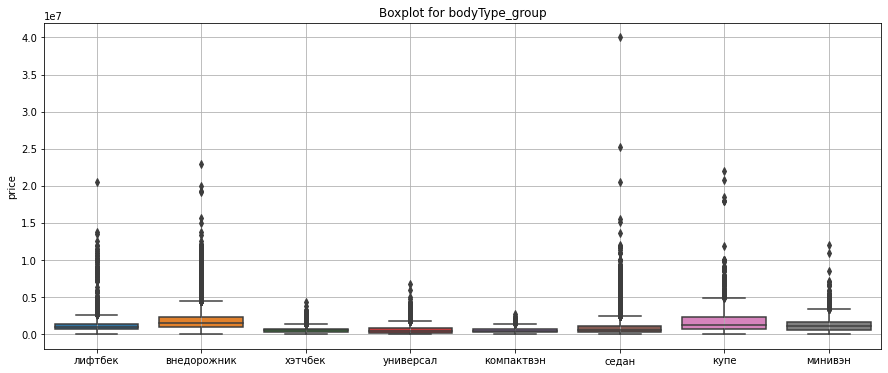

In [97]:
col = 'bodyType_group'
plot_cat_col_vs_price(df, col, 8)
rcParams['figure.figsize'] = 15,6

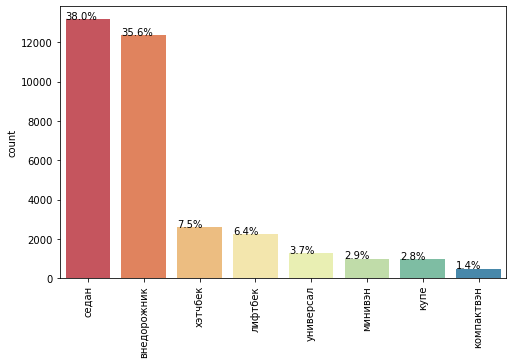

In [107]:
col = 'bodyType_group'
categorial_feature(df_test, col, 8, rotate=90)

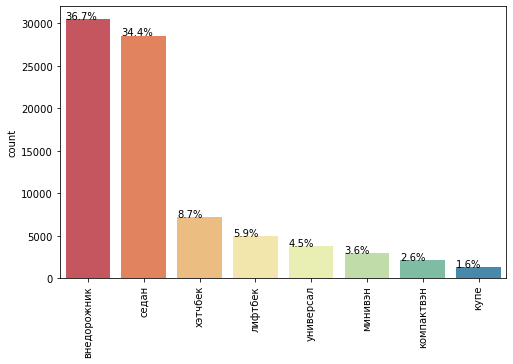

In [106]:
categorial_feature(df, col, 8, rotate=90)

Видим много выбросов, скорее всего сказываются цены на премиальные марки, в дальнейшем сгруппируем по ценовому сегменту

In [90]:
# Создадим сегменты бранда
df['segment_brand'] = df['brand'].apply(lambda x: 'PREMIUM' if x in [
    'AUDI','VOLVO','BMW','INFINITI','MERCEDES','LEXUS'] else 'MASS_BRAND')
df_test['segment_brand'] = df_test['brand'].apply(lambda x: 'PREMIUM' if x in [
    'AUDI','VOLVO','BMW','INFINITI','MERCEDES','LEXUS'] else 'MASS_BRAND')
    
binary_list('segment_brand')

['morfology', 'vendor', 'ПТС', 'Руль', 'segment_brand']


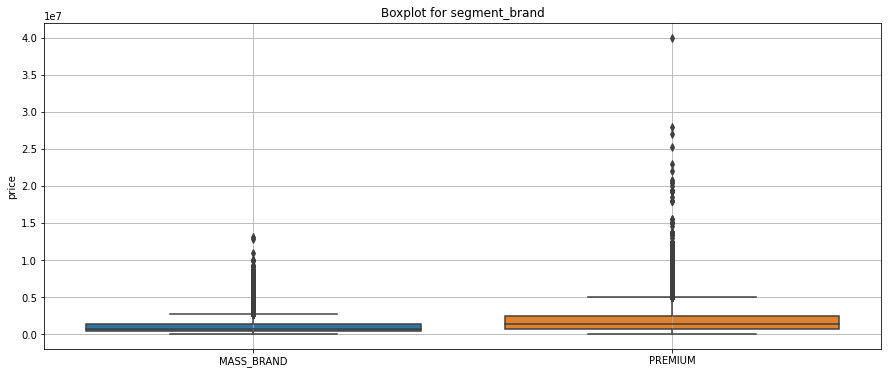

In [100]:
col = 'segment_brand'
plot_cat_col_vs_price(df, col, 8)
rcParams['figure.figsize'] = 8,5

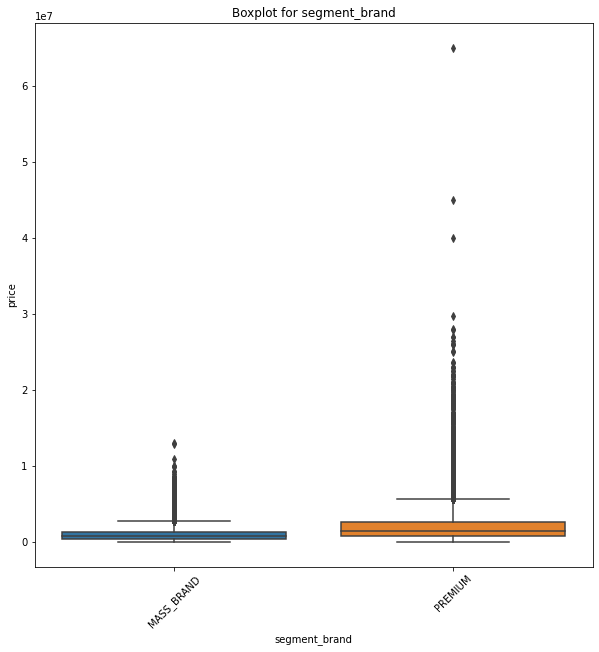

In [56]:
get_boxplot('segment_brand',df)

Предположение стоимости бренда подтвердилась. Посмотрим на среднюю стоимость по каждому классу бренда.

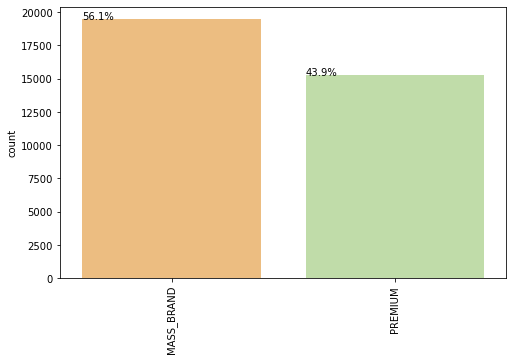

In [101]:
col = 'segment_brand'
categorial_feature(df_test, col, 8, rotate=90)

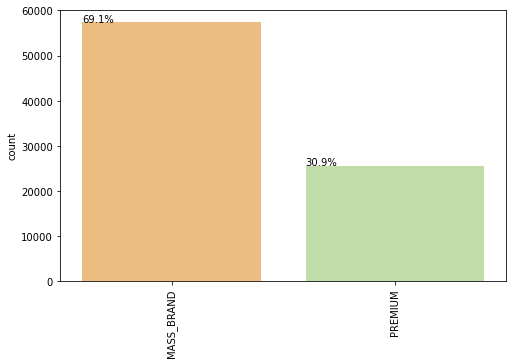

In [102]:
categorial_feature(df, col, 8, rotate=90)

в тестовом датесете разница между соотношением премиальных марок и масс-маркета существенно не отличаются, но в тренировочном разница уже существенна - 70% против 30% в пользу масс-маркета, т.е народ стал больше продавать бюджетные авто

In [112]:
print(df[df['segment_brand'] == 'PREMIUM'].groupby(
    'bodyType_group')['price'].median().sort_values(ascending=False))

print(df[df['segment_brand'] == 'MASS_BRAND'].groupby(
    'bodyType_group')['price'].median().sort_values(ascending=False))

# Проранжируем по медианной стоимости
body_range = list(df[df['segment_brand'] == 'PREMIUM'].groupby(
    'bodyType_group')['price'].median().sort_values(ascending=False).index)

df.loc[df[df['segment_brand'] == 'PREMIUM'].index,'body_range'] = df[
    df['segment_brand'] == 'PREMIUM']['bodyType_group'].apply(lambda x: body_range.index(x))

# df_test.loc[df_test[df_test['segment_brand'] == 'PREMIUM'].index,'body_range'] = df_test[
#     df_test['segment_brand'] == 'PREMIUM']['bodyType_group'].apply(lambda x: body_range.index(x))

body_range = list(df[df['segment_brand'] == 'MASS_BRAND'].groupby(
    'bodyType_group')['price'].median().sort_values(ascending=False).index)

df.loc[df[df['segment_brand'] == 'MASS_BRAND'].index,'body_range'] = df[
    df['segment_brand'] == 'MASS_BRAND']['bodyType_group'].apply(lambda x: body_range.index(x))

df_test.loc[df_test[df_test['segment_brand'] == 'MASS_BRAND'].index,'body_range'] = df_test[
    df_test['segment_brand'] == 'MASS_BRAND']['bodyType_group'].apply(lambda x: body_range.index(x))

category_list('body_range')

bodyType_group
родстер        2370000
лифтбек        1997000
внедорожник    1990000
купе           1553000
кабриолет      1550000
компактвэн     1415000
минивэн        1345000
лимузин         999000
седан           870000
хэтчбек         850000
универсал       670000
фургон          499000
Name: price, dtype: int64
bodyType_group
тарга          3789000
пикап          1374500
внедорожник    1300000
минивэн        1050000
кабриолет       835000
лифтбек         825000
родстер         672500
седан           540000
хэтчбек         475000
микровэн        465000
фургон          435000
компактвэн      430000
купе            420000
универсал       310000
Name: price, dtype: int64
['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate', 'model_name', 'numberOfDoors', 'Владельцы', 'Привод', 'bodyType_group', 'body_range']


<h3>Итог по bodyType:</h3> немного обобщили группы, сегментировали по бренду, проранжировали по медианной стоимости

## brand

In [114]:
category_list('brand')

['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate', 'model_name', 'numberOfDoors', 'Владельцы', 'Привод', 'bodyType_group', 'body_range']


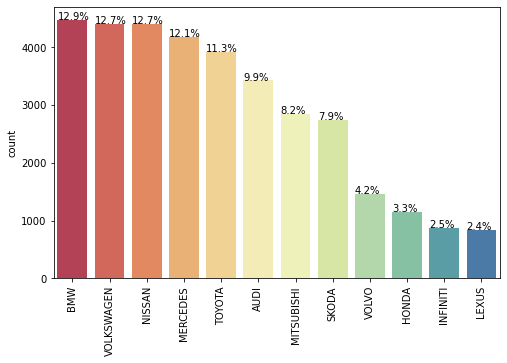

In [121]:
col = 'brand'
categorial_feature(df_test, col, 12, rotate=90)

rcParams['figure.figsize'] = 8,5

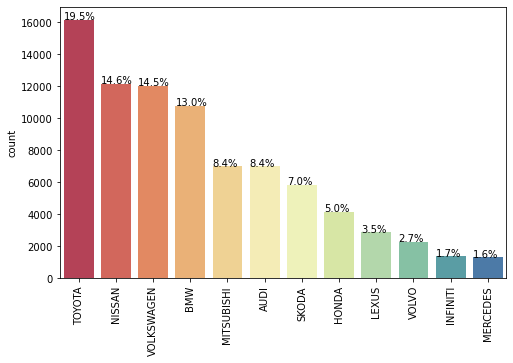

In [122]:
categorial_feature(df, col, 12, rotate=90)

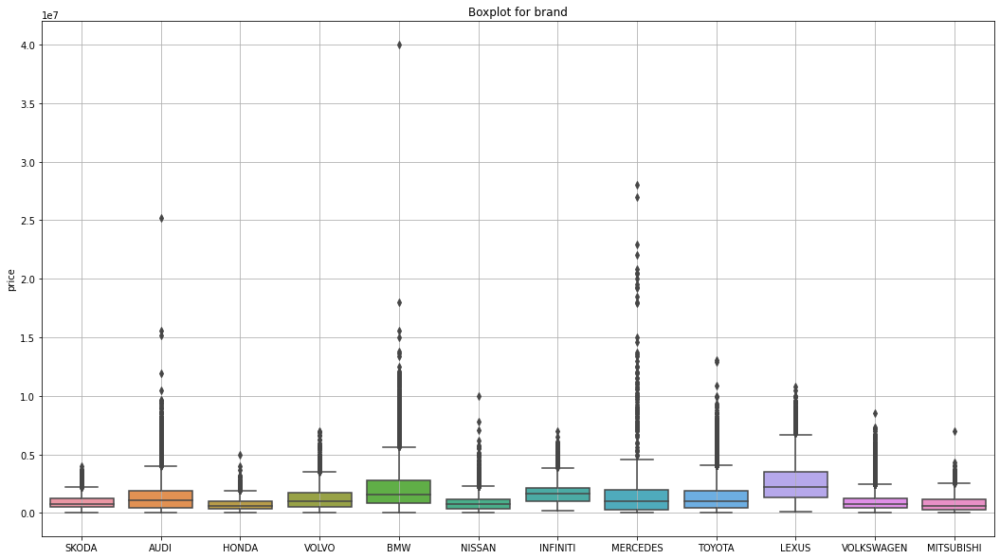

In [124]:
col = 'brand'
plot_cat_col_vs_price(df, col, 12)

rcParams['figure.figsize'] = 18,10

как видно по boxplot самая высокая цена ожидаемо наблюдается у авто марки lexus, infiniti и bmw

Распределение в датасетах по брендам не равномерное, будем предсказывать цену предварительно поделив выборку на бренды,выбросы по цене в брендах, на это может влиять год производства, комплектация, пробег, модель авто

## color

In [125]:
# посмотрим на медианную стоимость цвета по классу
df[df['segment_brand'] == 'PREMIUM'].groupby(
    'color')['price'].median().sort_values(ascending=False)

df[df['segment_brand'] == 'MASS_BRAND'].groupby(
    'color')['price'].median().sort_values(ascending=False)

# Проранжируем по медианной стоимости
color_range = list(df[df['segment_brand'] == 'PREMIUM'].groupby(
    'color')['price'].median().sort_values(ascending=False).index)

df.loc[df[df['segment_brand'] == 'PREMIUM'].index,'color_range'] = df[
    df['segment_brand'] == 'PREMIUM']['color'].apply(lambda x: color_range.index(x))

df_test.loc[df_test[df_test['segment_brand'] == 'PREMIUM'].index,'color_range'] = df_test[
    df_test['segment_brand'] == 'PREMIUM']['color'].apply(lambda x: color_range.index(x))

color_range = list(df[df['segment_brand'] == 'MASS_BRAND'].groupby(
    'color')['price'].median().sort_values(ascending=False).index)

df.loc[df[df['segment_brand'] == 'MASS_BRAND'].index,'color_range'] = df[
    df['segment_brand'] == 'MASS_BRAND']['color'].apply(lambda x: color_range.index(x))

df_test.loc[df_test[df_test['segment_brand'] == 'MASS_BRAND'].index,'color_range'] = df_test[
    df_test['segment_brand'] == 'MASS_BRAND']['color'].apply(lambda x: color_range.index(x))

category_list('color_range')

['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate', 'model_name', 'numberOfDoors', 'Владельцы', 'Привод', 'bodyType_group', 'body_range', 'color_range']


In [126]:
df[df['segment_brand'] == 'MASS_BRAND'].groupby(
    'color')['price'].median().sort_values(ascending=False)

color
коричневый     1224500
чёрный          970000
белый           920000
бежевый         800000
фиолетовый      779990
серый           680000
серебристый     650000
пурпурный       617000
золотистый      560000
жёлтый          550000
оранжевый       547000
синий           520000
красный         500000
голубой         495000
розовый         440000
зелёный         300000
Name: price, dtype: int64

In [127]:
df[df['segment_brand'] == 'PREMIUM'].color.value_counts()

чёрный         9039
белый          4959
серый          3192
синий          2697
серебристый    1697
коричневый     1163
красный        1024
зелёный         583
бежевый         380
голубой         244
пурпурный       186
золотистый      183
оранжевый       122
фиолетовый      109
жёлтый           59
розовый           5
Name: color, dtype: int64

In [128]:
df[df['segment_brand'] == 'MASS_BRAND'].color.value_counts()

белый          13352
чёрный         12765
серебристый     8420
серый           8378
синий           4532
красный         2800
зелёный         1848
коричневый      1822
бежевый          976
голубой          710
золотистый       436
пурпурный        414
фиолетовый       379
жёлтый           300
оранжевый        163
розовый           35
Name: color, dtype: int64

<h3>Итог по color:</h3> проранжировали по медианной стоимости, интересно, что популярность цвета отличается от стоимости бренда

## engineDisplacement, engineDisplacement_num

Сгрупируем по объему: микролитражные (до 1,1 л), малолитражные (1,2-1,5 л), среднелитражные (1,6-3,5 л) и крупнолитражные (свыше 3,5 л)

In [129]:
df['engineDisplacement_group'] = df['engineDisplacement_num'].apply(lambda x: 'микролитражные' if 0 < x <= 1.1
                                                                    else 'электро' if x == 0
                                                                    else 'малолитражные' if 1.1 < x <= 1.5 else 'среднелитражные' if 1.5 < x <= 3.5
                                                                    else 'крупнолитражные')

df_test['engineDisplacement_group'] = df_test['engineDisplacement_num'].apply(lambda x: 'микролитражные' if 0 < x <= 1.1
                                                                              else 'электро' if x == 0
                                                                              else 'малолитражные' if 1.1 < x <= 1.5
                                                                              else 'среднелитражные' if 1.5 < x <= 3.5
                                                                              else 'крупнолитражные')
category_list('engineDisplacement_group')

['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate', 'model_name', 'numberOfDoors', 'Владельцы', 'Привод', 'bodyType_group', 'body_range', 'color_range', 'engineDisplacement_group']


In [130]:
compare_cols('engineDisplacement_group')

,engineDisplacement_group_x,engineDisplacement_group_y
среднелитражные,65006,27825
малолитражные,10613,3210
крупнолитражные,6206,3482
микролитражные,800,114
электро,347,55


In [131]:
df.groupby('engineDisplacement_group')['price'].median().sort_values(ascending=False)

engineDisplacement_group
крупнолитражные    1989000
среднелитражные     900000
электро             795000
малолитражные       599000
микролитражные      420000
Name: price, dtype: int64

<h3>Итог по engineDisplacement:</h3> сгрупировали по объему двигателя, выше объем больше стоимость, интересно что электрокары оказались по стоимости между малолитражными и среднелитражными

## enginePower

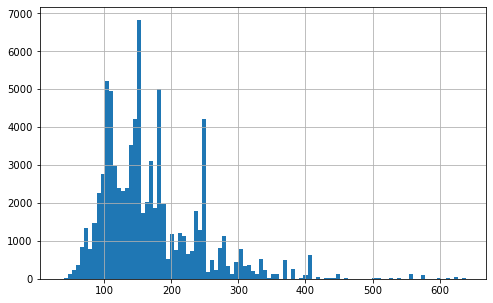

In [164]:
df.enginePower.hist(bins = 100)

rcParams['figure.figsize'] = 8,5

In [151]:
def scatter_num_feature(data, scat):
        data.plot(x = scat, y = 'price', kind = 'scatter', c= '#9467bd', grid = True, title = f"Price VS {scat}")

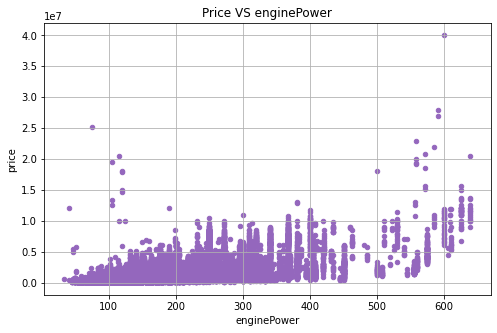

In [150]:
scatter_num_feature(df, 'enginePower')

In [152]:
# сгруппируем, воспользовавшись стандартным отклонением
IQR = df.enginePower.quantile(
    0.75) - df.enginePower.quantile(0.25)
perc25 = df.enginePower.quantile(0.25)
perc75 = df.enginePower.quantile(0.75)
print('25th percentile: {},'.format(perc25), '75th percentile: {},'.format(perc75),
      "IQR: {}, ".format(IQR), "Пределы: [{f}, {l}].".format(f=perc25 - 1.5*IQR, l=perc75 + 1.5*IQR))

# Стандартное отклонение
s = np.std(df.enginePower, ddof=1)
m = df.enginePower.mean()

25th percentile: 114.0, 75th percentile: 201.0, IQR: 87.0,  Пределы: [-16.5, 331.5].


In [153]:
df['enginePower_group'] = df.enginePower.apply(lambda x: 'low' if x <= 118 else 'medium' if 118 < x < 220
                                               else 'hight' if 220 <= x < 373 else 'extra_hight')
df_test['enginePower_group'] = df_test.enginePower.apply(lambda x: 'low' if x <= 118 else 'medium' if 118 < x < 220
                                               else 'hight' if 220 <= x < 373 else 'extra_hight')
category_list('enginePower_group')

['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate', 'model_name', 'numberOfDoors', 'Владельцы', 'Привод', 'bodyType_group', 'body_range', 'color_range', 'engineDisplacement_group', 'enginePower_group']


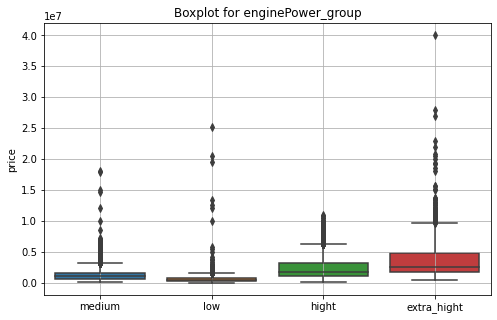

In [157]:
col = 'enginePower_group'
plot_cat_col_vs_price(df, col, 12)

rcParams['figure.figsize'] = 8,5

In [155]:
# посмотрим на модели дадим и название LUXE
print(df.query('enginePower > 373')['model_name'].value_counts())
print(df_test.query('enginePower > 373')['model_name'].value_counts())

for i in df.query('enginePower > 373').index:
    df.loc[i, 'segment_brand'] = 'LUXE'
    
for i in df_test.query('enginePower > 373').index:
    df_test.loc[i, 'segment_brand'] = 'LUXE'

7ER              223
X6_M             144
X6               132
PATROL           120
X5               117
QX80             113
LS                96
X5_M              93
QX56              89
TUNDRA            76
M5                52
AMG_GT            51
5ER               37
A8                34
6ER               32
M4                26
LX                25
SEQUOIA           24
M3                22
FX                22
X7                19
GT_R              18
M6                17
Q7                12
E_TRON            11
S8                11
8ER               11
GLA_CLASS_AMG     10
S6                 9
Q50                9
Q60                8
R8                 6
3ER                5
M2                 5
S7                 5
SLS_AMG            4
TT_RS              4
MAYBACH_GLS        4
PHAETON            2
XC90               2
M                  2
TOUAREG            2
Q70                2
LAND_CRUISER       2
X4_M               1
Name: model_name, dtype: int64
S_CLASS        219
7ER  

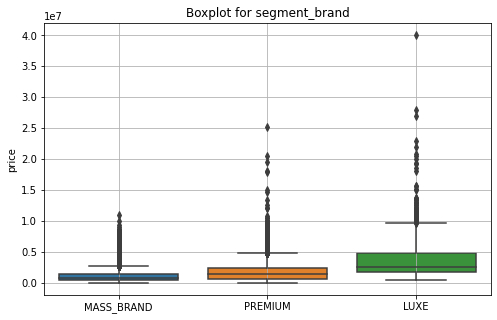

In [158]:
col = 'segment_brand'
plot_cat_col_vs_price(df, col, 12)

<h3>Итог по enginePower:</h3> есть небольшая корреляция с ценой, создали групы на основании мощности двигателя, добавили новый сегмент в segment_brand

## fuelType

In [159]:
compare_cols('fuelType')

,fuelType_x,fuelType_y
бензин,66902,28601
дизель,13786,5800
гибрид,1917,223
электро,347,55
газ,20,7


In [160]:
df.groupby('fuelType')['price'].median().sort_values(ascending=False)

fuelType
дизель     1716000
гибрид     1250000
бензин      800000
электро     795000
газ         705000
Name: price, dtype: int64

## mileage

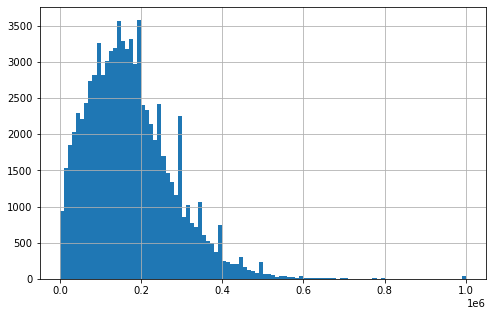

In [163]:
df.mileage.hist(bins = 100)

rcParams['figure.figsize'] = 8,5

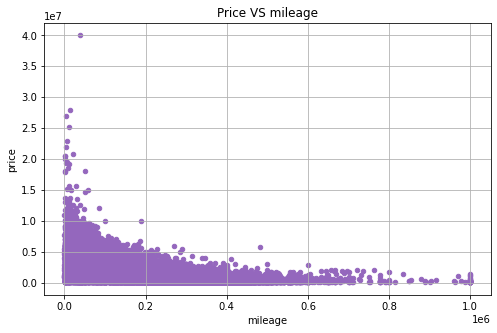

In [166]:
scatter_num_feature(df, 'mileage')

In [167]:
df.groupby('brand')['mileage'].mean().sort_values(ascending=False)

brand
MERCEDES      223678.571213
HONDA         197368.492659
MITSUBISHI    194531.158556
AUDI          189691.052436
VOLVO         187787.116535
TOYOTA        186752.321349
VOLKSWAGEN    178220.945207
NISSAN        169252.596212
BMW           159060.754040
LEXUS         145165.442941
SKODA         142370.700822
INFINITI      141022.447954
Name: mileage, dtype: float64

In [168]:
df_test.groupby('brand')['mileage'].mean().sort_values(ascending=False)

brand
HONDA         203025.625217
MITSUBISHI    188924.850510
VOLVO         187124.459330
TOYOTA        181501.453616
AUDI          174743.211926
VOLKSWAGEN    168751.805858
NISSAN        157078.144776
LEXUS         148815.035971
SKODA         142461.247355
INFINITI      142267.498278
BMW           139011.937402
MERCEDES      137215.918900
Name: mileage, dtype: float64

Важный признак, используем его для создания новых

## modelDate

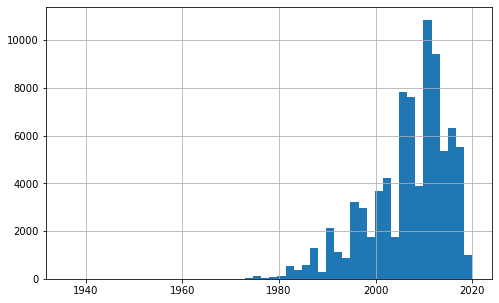

In [170]:
df.modelDate.hist(bins = 50)

rcParams['figure.figsize'] = 8,5

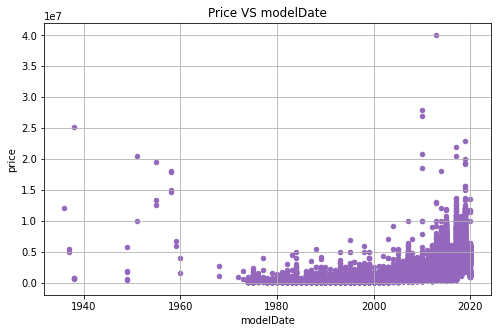

In [172]:
scatter_num_feature(df, 'modelDate')

In [173]:
# разделим на категории основываясь по дате модели
df['modelDate_group'] = df['modelDate'].apply(lambda x: 'раритет' if x <= 1970 else 'старейшие' if 1970 < x < 2000
                                              else 'старые' if 2000 <= x < 2010
                                              else 'новые' if 2010 <= x < 2015
                                              else 'новейшие')
df_test['modelDate_group'] = df['modelDate'].apply(lambda x: 'раритет' if x <= 1970 else 'старейшие' if 1970 < x < 2000
                                                   else 'старые' if 2000 <= x < 2010
                                                   else 'новые' if 2010 <= x < 2015
                                                   else 'новейшие')


category_list('modelDate_group')

['bodyType', 'brand', 'color', 'engineDisplacement', 'fuelType', 'modelDate', 'model_name', 'numberOfDoors', 'Владельцы', 'Привод', 'bodyType_group', 'body_range', 'color_range', 'engineDisplacement_group', 'enginePower_group', 'modelDate_group']


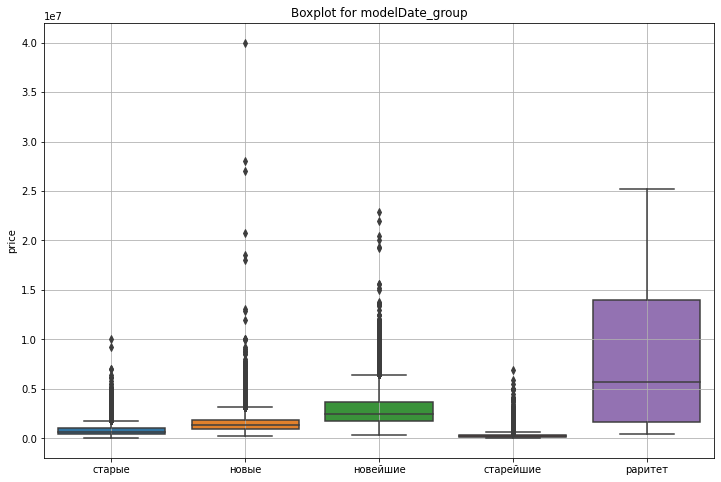

In [176]:
col = 'modelDate_group'
plot_cat_col_vs_price(df, col, 12)

rcParams['figure.figsize'] = 12,8

In [177]:
compare_cols('modelDate_group')

,modelDate_group_x,modelDate_group_y
старые,28951,12780
новые,25628,11591
старейшие,15527,4509
новейшие,12839,5798
раритет,27,8


In [178]:
# Посмотрим на productionDate и modelDate

df['fresh_model'] = df.productionDate - df.modelDate
df_test['fresh_model'] = df_test.productionDate - df_test.modelDate

numerical_list('fresh_model')


['engineDisplacement_num', 'enginePower', 'len_quip_list', 'mileage', 'productionDate', 'clearance_min_super_gen', 'model_age_month', 'car_age_month', 'fresh_model']


## model_name

In [179]:
df.groupby('model_name')['price'].max().sort_values(ascending=False)

model_name
M5             40000000
SLS_AMG        28000000
920            25200000
MAYBACH_GLS    22900000
AMG_GT         21999000
                 ...   
CYNOS            200000
COROLLA_II       190000
CAVALIER         175000
CONCERTO         125000
TARO             121034
Name: price, Length: 470, dtype: int64

## numberOfDoors

In [180]:
df.groupby('numberOfDoors')['price'].median().sort_values(ascending=False)

numberOfDoors
2    1250000.0
5    1146631.5
4     635000.0
3     360000.0
Name: price, dtype: float64

## productionDate

In [181]:
# Создадим признак пробег в месяц
df['mileage_age'] = df.mileage/df.car_age_month
df['mileage_owners'] = df.mileage/df.Владельцы

df_test['mileage_age'] = df.mileage/df.car_age_month
df_test['mileage_owners'] = df.mileage/df.Владельцы


numerical_list('mileage_age')
numerical_list('mileage_owners')

['engineDisplacement_num', 'enginePower', 'len_quip_list', 'mileage', 'productionDate', 'clearance_min_super_gen', 'model_age_month', 'car_age_month', 'fresh_model', 'mileage_age']
['engineDisplacement_num', 'enginePower', 'len_quip_list', 'mileage', 'productionDate', 'clearance_min_super_gen', 'model_age_month', 'car_age_month', 'fresh_model', 'mileage_age', 'mileage_owners']


## vehicleTransmission

In [182]:
compare_cols('vehicleTransmission')

,vehicleTransmission_x,vehicleTransmission_y
автоматическая,42225,19596
механическая,20345,7209
вариатор,12064,3999
роботизированная,8338,3882


In [183]:
df.groupby('vehicleTransmission')['price'].median().sort_values(ascending=False)

vehicleTransmission
роботизированная    1370000
автоматическая      1150000
вариатор            1053500
механическая         440000
Name: price, dtype: int64

## vendor

In [184]:
compare_cols('vendor')

,vendor_x,vendor_y
JAPANESE,43743,14004
EUROPEAN,39229,20682


## Владельцы

In [185]:
df.groupby('Владельцы')['price'].median().sort_values(ascending=False)

Владельцы
1.0    1520000
2.0    1187000
3.0     600000
Name: price, dtype: int64

## ПТС

In [186]:
df.groupby('ПТС')['price'].median().sort_values(ascending=False)

ПТС
ORIGINAL     985000
DUPLICATE    550000
Name: price, dtype: int64

## Привод

In [187]:
df.groupby('Привод')['price'].median().sort_values(ascending=False)

Привод
ALL_WHEEL_DRIVE    1550000
REAR_DRIVE          730000
FORWARD_CONTROL     615000
Name: price, dtype: int64

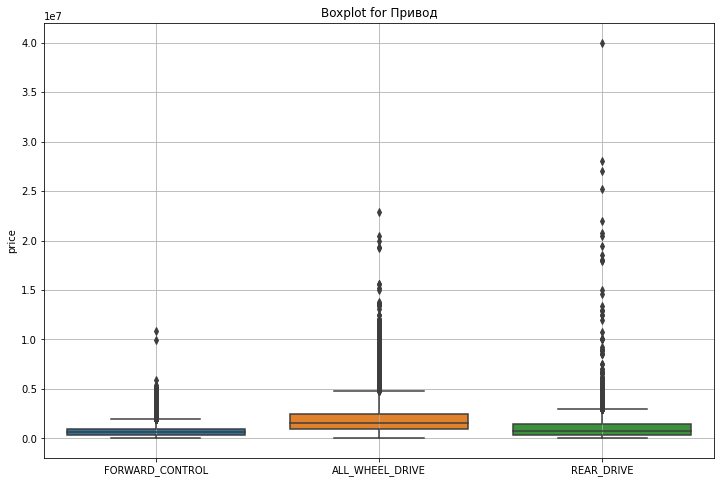

In [188]:
col = 'Привод'
plot_cat_col_vs_price(df, col, 12)

rcParams['figure.figsize'] = 12,8

Полноприводные модели дороже, задний привод в целом дешевле, но сказывается стоимость люкса

## Руль

In [189]:
df.groupby('Руль')['price'].median().sort_values(ascending=False)

Руль
LEFT     999000
RIGHT    400000
Name: price, dtype: int64

In [190]:
len(cat_list)+len(bin_list)+len(num_list)+len(dum_list) == len(df.drop(['sell_id','price'],axis=1).columns)


False

## Корреляция признаков

<AxesSubplot:>

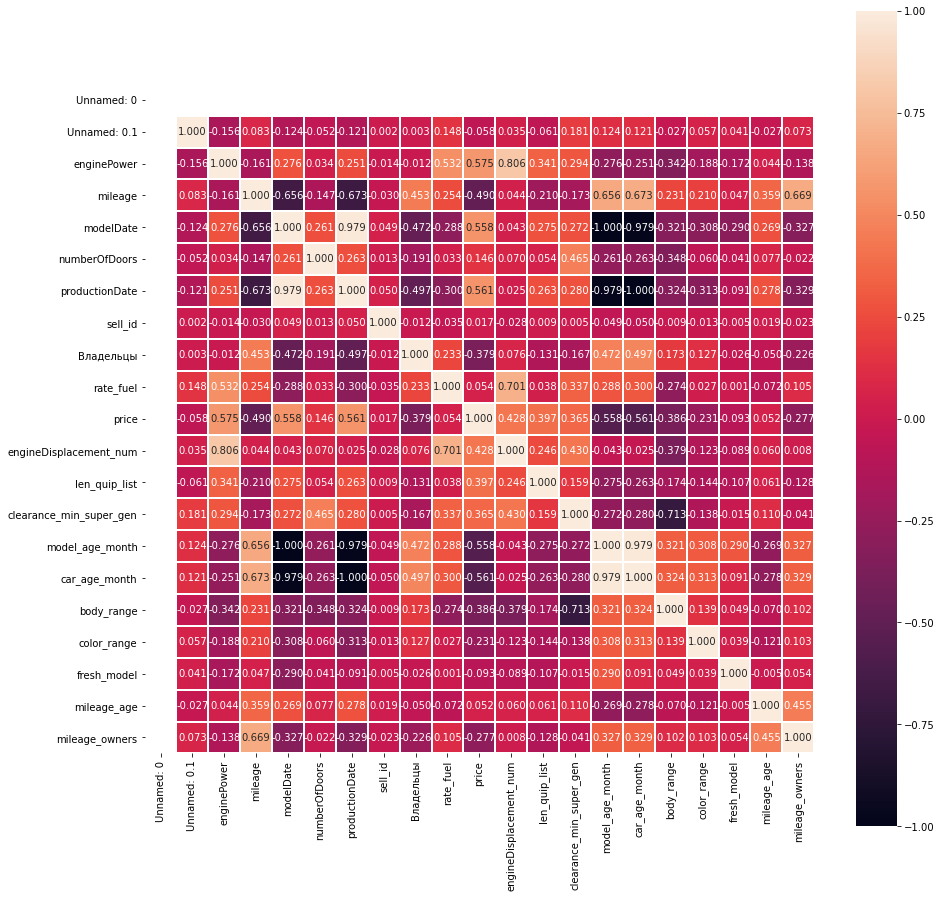

In [191]:
fig, ax = plt.subplots(figsize=(15,15)) 
sns.heatmap(df.corr(), vmin=-1, vmax=1, square=True,
              annot=True, fmt=".3f", linewidths=1,ax=ax)

In [194]:
df_corr = pd.DataFrame(df.corr())
help_list=[]
for i in df_corr:
    for n in df_corr[i]:
        if df_corr.index[df_corr[i]== n][0] != i:
            if n> 0.6 or n<-0.6:
                if n not in help_list:
                    help_list.append(n)
                    print('Row/Col :','\n',df_corr.index[df_corr[i]== n][0],'/',i,'\n', n,'\n')

IndexError: index 0 is out of bounds for axis 0 with size 0

In [193]:
df_corr = pd.DataFrame(df_test.drop('price',axis=1).corr())
help_list=[]
for i in df_corr:
    for n in df_corr[i]:
        if df_corr.index[df_corr[i]== n][0] != i:
            if n> 0.6 or n<-0.6:
                if n not in help_list:
                    help_list.append(n)
                    print('Row/Col :','\n',df_corr.index[df_corr[i]== n][0],'/',i,'\n', n,'\n')

Row/Col : 
 Unnamed: 0 / Unnamed: 0.1 
 1.0 

Row/Col : 
 engineDisplacement_num / enginePower 
 0.8408190452963543 

Row/Col : 
 modelDate / mileage 
 -0.6511527161668826 

Row/Col : 
 productionDate / mileage 
 -0.671299535414925 

Row/Col : 
 model_age_month / mileage 
 0.6511527161668507 

Row/Col : 
 car_age_month / mileage 
 0.6712995354149359 

Row/Col : 
 productionDate / modelDate 
 0.9742932794330982 

Row/Col : 
 model_age_month / modelDate 
 -0.9999999999999046 

Row/Col : 
 car_age_month / modelDate 
 -0.9742932794332048 

Row/Col : 
 model_age_month / productionDate 
 -0.9742932794331687 

Row/Col : 
 car_age_month / productionDate 
 -1.0000000000000664 

Row/Col : 
 engineDisplacement_num / rate_fuel 
 0.7323334381933999 

Row/Col : 
 body_range / clearance_min_super_gen 
 -0.6237908726255686 

Row/Col : 
 car_age_month / model_age_month 
 0.9742932794331229 



In [195]:
# удалим признаки с сильной корреляцией

df = df.drop(['productionDate','modelDate'],axis=1)
df_test = df_test.drop(['productionDate','modelDate'],axis=1)

num_list.remove('productionDate')
cat_list.remove('modelDate')

In [196]:
len(cat_list)+len(bin_list)+len(num_list)+len(dum_list) == len(df.drop(['sell_id','price'],axis=1).columns)

False

In [197]:
dtype = dict(df.dtypes == df_test.dtypes)
for i in dtype:
    if dtype[i] == False:
        print(i,'\n',
              'df',df.dtypes[i],'\n',
              'df_test',df_test.dtypes[i])

Unnamed: 0 
 df float64 
 df_test int64
Владельцы 
 df float64 
 df_test int64


In [103]:
df['Владельцы'] = df['Владельцы'].apply(lambda x: int(x))

## Объеденим данные

In [200]:
data = df_test.append(df, sort=False).reset_index(drop=True)

In [105]:
data.select_dtypes(include='float').columns

Index(['engineDisplacement_num', 'body_range', 'color_range', 'mileage_age',
       'mileage_owners'],
      dtype='object')

In [106]:
for i in ['body_range', 'color_range']:
    data[i] = data[i].apply(lambda x: int(x))

In [107]:
X = data.query('price != 0').drop(['price','sell_id'],axis=1)
X.shape

(94549, 32)

In [108]:
X_val = data.query('price == 0').drop(['price','sell_id'],axis=1)
X_val.shape

(34686, 32)

In [109]:
y = data.query('price != 0')['price']
y.shape

(94549,)

# Machine Learning

## CatBoostRegressor

### Подберем категориальные признаки

In [110]:
cat_col = list(X.select_dtypes(include='object').columns)
cat_col.remove('equipment_list') # удалим колонку для dumm

# разделим выборку на train и test
X_train, X_test, y_train, y_test = train_test_split(X[cat_col], np.log(y), test_size=0.30, random_state=42)

# подготовим категориальные признаки
features_for_select = cat_col
cat_features = cat_col
feature_names =  cat_col

# подготовим Pool
train_pool = Pool(X_train, y_train, feature_names = feature_names, cat_features = cat_features)
test_pool = Pool(X_test, y_test, feature_names = feature_names,cat_features = cat_features)

# модель на 5 000 итераций learning_rate = 0.1
model = CatBoostRegressor(iterations=10000, 
                              random_seed=42,
                              learning_rate = 0.1,
                              eval_metric='MAPE',
                              od_type = 'Iter',
                              od_wait = 200,
                              silent=True)

# выбор категориальных признаков из 13 выберем 5 важных
summary = model.select_features(
    train_pool,
    eval_set=test_pool,
    features_for_select= features_for_select,
    num_features_to_select=7,
    steps=14,
    algorithm=EFeaturesSelectionAlgorithm.RecursiveByShapValues,
    shap_calc_type=EShapCalcType.Regular,
    train_final_model=True,
    logging_level='Silent',
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

The number of features selection steps (14) is greater than the number of features to eliminate (10). The number of steps was reduced to 10.


In [111]:
summary['selected_features_names']

['brand',
 'engineDisplacement',
 'fuelType',
 'model_name',
 'bodyType_group',
 'enginePower_group',
 'modelDate_group']

### Подберем числовые признаки

In [112]:
num_col = list(X.select_dtypes(include='int').columns) + list(X.select_dtypes(include='float').columns)

X_num_CatB_SS = StandardScaler().fit_transform(X[num_col].values)

# разделим выборку на train и test
X_train, X_test, y_train, y_test = train_test_split(X_num_CatB_SS, np.log(y), test_size=0.30, random_state=42)

# подготовим категориальные признаки
features_for_select = num_col
feature_names =  num_col

# подготовим Pool
train_pool = Pool(X_train, y_train, feature_names = feature_names)
test_pool = Pool(X_test, y_test, feature_names = feature_names)

# модель на 10 000 итераций learning_rate = 0.1
model = CatBoostRegressor(iterations=10000, 
                              random_seed=42,
                              learning_rate = 0.1,
                              eval_metric='MAPE',
                              od_type = 'Iter',
                              od_wait = 200,
                              silent=True)

# выбор категориальных признаков из 13 выберем 5 важных
summary_num = model.select_features(
    train_pool,
    eval_set=test_pool,
    features_for_select= features_for_select,
    num_features_to_select=6,
    steps=10,
    algorithm=EFeaturesSelectionAlgorithm.RecursiveByShapValues,
    shap_calc_type=EShapCalcType.Regular,
    train_final_model=True,
    logging_level='Silent',
    plot=True
)

The number of features selection steps (10) is greater than the number of features to eliminate (8). The number of steps was reduced to 8.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [113]:
summary_num['selected_features_names']

['enginePower',
 'mileage',
 'model_age_month',
 'car_age_month',
 'body_range',
 'engineDisplacement_num']

### Подготовим модель на выбранных признаках

In [114]:
# числовые признаки
sc = StandardScaler()

X_CatB_num = StandardScaler().fit_transform(data[summary_num['selected_features_names']])
X_CatB_num = pd.DataFrame(X_CatB_num, columns = summary_num['selected_features_names'])
X_CatB_num

,enginePower,mileage,model_age_month,car_age_month,body_range,engineDisplacement_num
0,-0.887565,-0.912257,-0.844109,-0.731466,-0.200086,-1.208646
1,-0.829997,-1.039044,-1.343778,-1.122641,-0.200086,-0.789963
2,-0.346425,-0.780157,-0.844109,-0.731466,-0.200086,-0.580622
3,-0.829997,-0.714107,-0.844109,-0.731466,-0.200086,-0.789963
4,-0.346425,-1.058171,-0.219522,-0.470683,-0.200086,-0.580622
...,...,...,...,...,...,...
129230,-1.152378,1.408929,3.038738,2.930363,0.402442,-0.580622
129231,-0.910592,2.210965,3.163655,2.930363,-1.103878,0.152072
129232,-1.129351,1.154165,3.413490,3.712713,0.402442,-0.057269
129233,-0.945133,-0.855642,3.538407,3.321538,-0.802614,-0.580622


In [115]:
# подготовим признаки из dum_list

mlb = MultiLabelBinarizer()

# equipment_dict

X_dumm_equipment_dict = pd.DataFrame(mlb.fit_transform(
    X['equipment_list']), columns=mlb.classes_, index=df.index)

X_val_dumm_equipment_dict = pd.DataFrame(mlb.fit_transform(
    X_val['equipment_list']), columns=mlb.classes_, index=df_test.index)

# приведем в соответсвие equipment_dict в df и df_test, удалим колонки которых нет в df и df_test соответственно 

delete_cols_df = []
for i in X_dumm_equipment_dict.columns:
    if i not in X_val_dumm_equipment_dict.columns:
        delete_cols_df.append(i)
        
delete_cols_df_test = []
for i in X_val_dumm_equipment_dict.columns:
    if i not in X_dumm_equipment_dict.columns:
        delete_cols_df_test.append(i)

dumm_equipment_dict = X_val_dumm_equipment_dict.drop(delete_cols_df_test, axis=1).append(
    X_dumm_equipment_dict.drop(delete_cols_df, axis=1), sort=False).reset_index(drop=True)


X_CatB_dumm = dumm_equipment_dict
X_CatB_dumm.shape

(129235, 177)

In [116]:
# категориальные признаки

X_CatB_category = data[summary['selected_features_names']]
X_CatB_category.shape

(129235, 7)

In [117]:
# Объеденим все признаки

X_CatB = X_CatB_category
for i in [X_CatB_dumm,X_CatB_num]:
    X_CatB = X_CatB.merge(i, left_index=True, right_index=True)

X_CatB.shape

(129235, 190)

In [118]:
# разделим на тест и валидацию
X_CatB_test = X_CatB.loc[data.query('price != 0').index]
X_CatB_val = X_CatB.loc[data.query('price == 0').index]

In [119]:
# подготовим модель, разобьем на три фолда

valid_frac = 0.15
test_frac = 0.15

valid_count = int(valid_frac * X.shape[0])
test_count = int(test_frac * X.shape[0])

X_train, X_valid_test, y_train, y_valid_test = train_test_split(X_CatB_test, y,
    test_size=(valid_count + test_count), random_state=42)

X_valid, X_test, y_valid, y_test = train_test_split(
    X_valid_test, y_valid_test, test_size=test_count, random_state=42)

In [120]:
# готовим pool

feature_names = list(X_CatB_test.columns)
cat_features = summary['selected_features_names']

pool = Pool(X_CatB_test, np.log(y), feature_names = feature_names, cat_features = cat_features)

In [121]:
# модель
cat_boost = CatBoostRegressor(iterations=10000, 
                              random_seed=42,
                              learning_rate = 0.1,
                              eval_metric='MAPE',
                              od_type = 'Iter',
                              od_wait = 200,
                              silent=True)
cat_boost.fit(
    X = pool, 
    eval_set=(X_test, np.log(y_test)),
    verbose_eval=0, 
    use_best_model=True, 
    plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [122]:
y_pred = np.exp(cat_boost.predict(X_test))
print(f"Точность модели по метрике MAPE: {(mape(y_test, y_pred))*100:0.2f}%")

Точность модели по метрике MAPE: 10.94%


In [123]:
y_pred = np.exp(cat_boost.predict(X_valid))
print(f"Точность модели по метрике MAPE: {(mape(y_valid, y_pred))*100:0.2f}%")

Точность модели по метрике MAPE: 10.86%


In [124]:
y_pred = np.exp(cat_boost.predict(X_CatB_val))
y_pred = [(x - x*0.28) for x in y_pred]
sample_submission['price'] = y_pred
sample_submission.to_csv('submission_1.csv', index=False)